# Airbnb dataset EDA and Visualization

## Importing libraries

In [1]:
import numpy as np  #importing libraries for EDA
import pandas as pd  #importing libraries for EDA

In [2]:
import matplotlib.pyplot as plt #importing libraries for visualization
import seaborn as sns  #importing libraries for visualization
import plotly.express as px  #importing libraries for visualization
import cufflinks as cf #importing libraries for visualization
cf.set_config_file(offline= True)

In [3]:
import plotly.io as pio
pio.renderers.default = "notebook"

In [4]:
import folium #importing libraries for visualization of lat. and long. on map

In [5]:
import warnings   # library to ignore unnecessary warnings
warnings.filterwarnings(action = "ignore")

## Reading the Airbnb dataset csv file

In [6]:
df = pd.read_csv("airbnb prices.csv")

## Initial investigation

In [7]:
df.head() #checking the dataset

,room_id,survey_id,host_id,room_type,country,city,borough,neighborhood,reviews,overall_satisfaction,accommodates,bedrooms,bathrooms,price,minstay,name,last_modified,latitude,longitude,location
0,10176931,1476,49180562,Shared room,NaN,Amsterdam,NaN,De Pijp / Rivierenbuurt,7,4.5,2,1.0,NaN,156.0,NaN,Red Light/ Canal view apartment (Shared),2017-07-23 13:06:27.391699,52.356209,4.887491,0101000020E610000033FAD170CA8C13403BC5AA41982D...
1,8935871,1476,46718394,Shared room,NaN,Amsterdam,NaN,Centrum West,45,4.5,4,1.0,NaN,126.0,NaN,Sunny and Cozy Living room in quite neighbours,2017-07-23 13:06:23.607187,52.378518,4.896120,0101000020E6100000842A357BA095134042791F477330...
2,14011697,1476,10346595,Shared room,NaN,Amsterdam,NaN,Watergraafsmeer,1,0.0,3,1.0,NaN,132.0,NaN,Amsterdam,2017-07-23 13:06:23.603546,52.338811,4.943592,0101000020E6100000A51133FB3CC613403543AA285E2B...
3,6137978,1476,8685430,Shared room,NaN,Amsterdam,NaN,Centrum West,7,5.0,4,1.0,NaN,121.0,NaN,Canal boat RIDE in Amsterdam,2017-07-23 13:06:22.689787,52.376319,4.890028,0101000020E6100000DF180280638F134085EE92382B30...
4,18630616,1476,70191803,Shared room,NaN,Amsterdam,NaN,De Baarsjes / Oud West,1,0.0,2,1.0,NaN,93.0,NaN,One room for rent in a three room appartment,2017-07-23 13:06:19.681469,52.370384,4.852873,0101000020E6100000CD902A8A57691340187B2FBE682F...


In [8]:
df.info() #extracting basic info from the dataset

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18723 entries, 0 to 18722
Data columns (total 20 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   room_id               18723 non-null  int64  
 1   survey_id             18723 non-null  int64  
 2   host_id               18723 non-null  int64  
 3   room_type             18723 non-null  object 
 4   country               0 non-null      float64
 5   city                  18723 non-null  object 
 6   borough               0 non-null      float64
 7   neighborhood          18723 non-null  object 
 8   reviews               18723 non-null  int64  
 9   overall_satisfaction  18723 non-null  float64
 10  accommodates          18723 non-null  int64  
 11  bedrooms              18723 non-null  float64
 12  bathrooms             0 non-null      float64
 13  price                 18723 non-null  float64
 14  minstay               0 non-null      float64
 15  name               

In [9]:
df["room_id"].nunique() #checking no. of unique room_id

18723

In [10]:
df["host_id"].nunique() #checking no. of unique host_id

15943

In [11]:
df["room_type"].nunique() #checking no. of unique room_type

3

In [12]:
df["neighborhood"].nunique() #checking no. of unique neighbourhood

23

In [13]:
df.describe() #extracting basic info about the numerical columns 

,room_id,survey_id,host_id,country,borough,reviews,overall_satisfaction,accommodates,bedrooms,bathrooms,price,minstay,latitude,longitude
count,1.872300e+04,18723.0,1.872300e+04,0.0,0.0,18723.000000,18723.000000,18723.000000,18723.000000,0.0,18723.000000,0.0,18723.000000,18723.000000
mean,1.120568e+07,1476.0,3.577612e+07,NaN,NaN,16.741548,3.301127,2.922021,1.430380,NaN,166.599477,NaN,52.365261,4.888585
std,6.082192e+06,0.0,3.758103e+07,NaN,NaN,33.522630,2.213558,1.327524,0.879019,NaN,108.943849,NaN,0.015142,0.034537
min,2.818000e+03,1476.0,2.234000e+03,NaN,NaN,0.000000,0.000000,1.000000,0.000000,NaN,12.000000,NaN,52.296200,4.763264
25%,6.050608e+06,1476.0,7.140879e+06,NaN,NaN,2.000000,0.000000,2.000000,1.000000,NaN,108.000000,NaN,52.355254,4.864344
50%,1.228287e+07,1476.0,1.988641e+07,NaN,NaN,6.000000,4.500000,2.000000,1.000000,NaN,144.000000,NaN,52.364628,4.885994
75%,1.661084e+07,1476.0,5.202680e+07,NaN,NaN,17.000000,5.000000,4.000000,2.000000,NaN,192.000000,NaN,52.374797,4.907480
max,2.000373e+07,1476.0,1.418319e+08,NaN,NaN,532.000000,5.000000,17.000000,10.000000,NaN,6000.000000,NaN,52.424980,5.027689


In [14]:
df.describe(include = object) #extracting basic info about the categorical columns 

,room_type,city,neighborhood,name,last_modified,location
count,18723,18723,18723,18671,18723,18723
unique,3,1,23,18150,18723,18723
top,Entire home/apt,Amsterdam,De Baarsjes / Oud West,Amsterdam,2017-07-23 13:06:27.391699,0101000020E610000033FAD170CA8C13403BC5AA41982D...
freq,14978,18723,3289,36,1,1


In [15]:
df.columns #description of all the columns

Index(['room_id', 'survey_id', 'host_id', 'room_type', 'country', 'city',
       'borough', 'neighborhood', 'reviews', 'overall_satisfaction',
       'accommodates', 'bedrooms', 'bathrooms', 'price', 'minstay', 'name',
       'last_modified', 'latitude', 'longitude', 'location'],
      dtype='object')

In [16]:
df.dtypes #data types of the columns

room_id                   int64
survey_id                 int64
host_id                   int64
room_type                object
country                 float64
city                     object
borough                 float64
neighborhood             object
reviews                   int64
overall_satisfaction    float64
accommodates              int64
bedrooms                float64
bathrooms               float64
price                   float64
minstay                 float64
name                     object
last_modified            object
latitude                float64
longitude               float64
location                 object
dtype: object

# Automated EDA using pandas profiling library

In [17]:
from pandas_profiling import ProfileReport

#### Report generation and saving :-

In [18]:
report = ProfileReport(df,explorative=True,dark_mode=True)
# report.to_file("pandas_profiling_EDA_report")

#### Displaying the report in jupyter notebook:-

In [19]:
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Data cleaning and preparation

In [20]:
df_clean = df.copy()

In [21]:
df_clean.head()

,room_id,survey_id,host_id,room_type,country,city,borough,neighborhood,reviews,overall_satisfaction,accommodates,bedrooms,bathrooms,price,minstay,name,last_modified,latitude,longitude,location
0,10176931,1476,49180562,Shared room,NaN,Amsterdam,NaN,De Pijp / Rivierenbuurt,7,4.5,2,1.0,NaN,156.0,NaN,Red Light/ Canal view apartment (Shared),2017-07-23 13:06:27.391699,52.356209,4.887491,0101000020E610000033FAD170CA8C13403BC5AA41982D...
1,8935871,1476,46718394,Shared room,NaN,Amsterdam,NaN,Centrum West,45,4.5,4,1.0,NaN,126.0,NaN,Sunny and Cozy Living room in quite neighbours,2017-07-23 13:06:23.607187,52.378518,4.896120,0101000020E6100000842A357BA095134042791F477330...
2,14011697,1476,10346595,Shared room,NaN,Amsterdam,NaN,Watergraafsmeer,1,0.0,3,1.0,NaN,132.0,NaN,Amsterdam,2017-07-23 13:06:23.603546,52.338811,4.943592,0101000020E6100000A51133FB3CC613403543AA285E2B...
3,6137978,1476,8685430,Shared room,NaN,Amsterdam,NaN,Centrum West,7,5.0,4,1.0,NaN,121.0,NaN,Canal boat RIDE in Amsterdam,2017-07-23 13:06:22.689787,52.376319,4.890028,0101000020E6100000DF180280638F134085EE92382B30...
4,18630616,1476,70191803,Shared room,NaN,Amsterdam,NaN,De Baarsjes / Oud West,1,0.0,2,1.0,NaN,93.0,NaN,One room for rent in a three room appartment,2017-07-23 13:06:19.681469,52.370384,4.852873,0101000020E6100000CD902A8A57691340187B2FBE682F...


In [22]:
df_clean.isnull().sum()

room_id                     0
survey_id                   0
host_id                     0
room_type                   0
country                 18723
city                        0
borough                 18723
neighborhood                0
reviews                     0
overall_satisfaction        0
accommodates                0
bedrooms                    0
bathrooms               18723
price                       0
minstay                 18723
name                       52
last_modified               0
latitude                    0
longitude                   0
location                    0
dtype: int64

<AxesSubplot:>

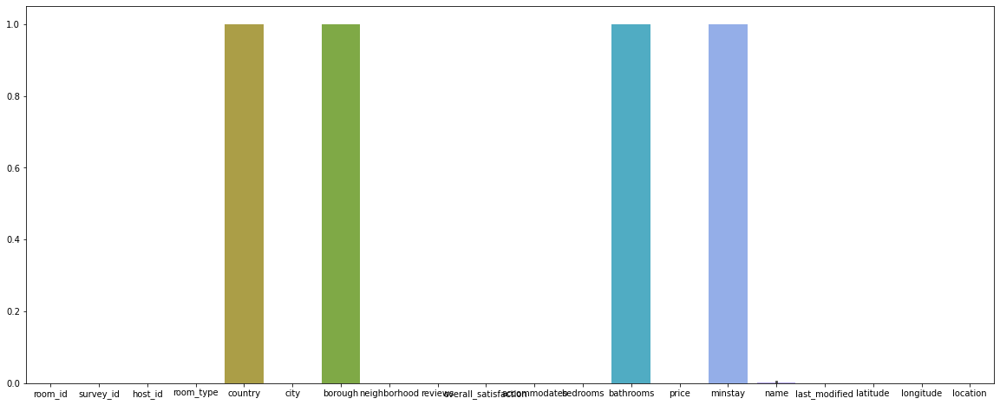

In [23]:
plt.figure(figsize=(20,8))
sns.barplot(df_clean.isnull())

#### From the above pandas profiling report & the above bar plot we can se that we are having missing values in the columns country, borough, bathrooms, minstays and name
#### We will handle these missing values under this data cleaning and preparation section

In [24]:
df_clean["country"].fillna(value = "Netherlands", axis = 0, inplace= True)

In [25]:
df_clean["country"].isna().sum()

0

In [26]:
df_clean["borough"].fillna(value = "Noord", axis=0, inplace = True)

In [27]:
df_clean["borough"].isna().sum()

0

In [28]:
df_clean["bathrooms"].fillna(value= 1, axis= 0, inplace= True) #As each airbnb will have atleast one bathroom

In [29]:
df_clean["bathrooms"].isna().sum()

0

In [30]:
df_clean["minstay"].fillna(value = "1 Day", axis = 0, inplace = True) #As people will stay atleast for one day

In [31]:
df_clean["minstay"].isna().sum()

0

In [32]:
df_clean["name"].value_counts()

Amsterdam                                             36
Lovely apartment near Vondelpark                      10
Magnificent panoramic city view                        8
Beautiful apartment in Amsterdam                       8
Cosy apartment in Amsterdam                            8
                                                      ..
Bright and trendy apt, sunny balcony -De Pijp, RAI     1
Bright & Cozy Apartment in the Pijp                    1
NEW! Monumental Apartment In The Heart of the City     1
A great apartment in Amsterdam’s vibrant ‘de Pijp’     1
I have a room available for rent                       1
Name: name, Length: 18150, dtype: int64

In [33]:
df_clean["name"].fillna(value = "Airbnb stay", axis = 0, inplace = True)

In [34]:
df_clean["name"].isna().sum()

0

In [35]:
df_clean.head(5)

,room_id,survey_id,host_id,room_type,country,city,borough,neighborhood,reviews,overall_satisfaction,accommodates,bedrooms,bathrooms,price,minstay,name,last_modified,latitude,longitude,location
0,10176931,1476,49180562,Shared room,Netherlands,Amsterdam,Noord,De Pijp / Rivierenbuurt,7,4.5,2,1.0,1.0,156.0,1 Day,Red Light/ Canal view apartment (Shared),2017-07-23 13:06:27.391699,52.356209,4.887491,0101000020E610000033FAD170CA8C13403BC5AA41982D...
1,8935871,1476,46718394,Shared room,Netherlands,Amsterdam,Noord,Centrum West,45,4.5,4,1.0,1.0,126.0,1 Day,Sunny and Cozy Living room in quite neighbours,2017-07-23 13:06:23.607187,52.378518,4.896120,0101000020E6100000842A357BA095134042791F477330...
2,14011697,1476,10346595,Shared room,Netherlands,Amsterdam,Noord,Watergraafsmeer,1,0.0,3,1.0,1.0,132.0,1 Day,Amsterdam,2017-07-23 13:06:23.603546,52.338811,4.943592,0101000020E6100000A51133FB3CC613403543AA285E2B...
3,6137978,1476,8685430,Shared room,Netherlands,Amsterdam,Noord,Centrum West,7,5.0,4,1.0,1.0,121.0,1 Day,Canal boat RIDE in Amsterdam,2017-07-23 13:06:22.689787,52.376319,4.890028,0101000020E6100000DF180280638F134085EE92382B30...
4,18630616,1476,70191803,Shared room,Netherlands,Amsterdam,Noord,De Baarsjes / Oud West,1,0.0,2,1.0,1.0,93.0,1 Day,One room for rent in a three room appartment,2017-07-23 13:06:19.681469,52.370384,4.852873,0101000020E6100000CD902A8A57691340187B2FBE682F...


#### df_clean is now a clean dataset which we have prepared for further data analysis and now there are no null values present in this dataset.
#### Note:- We have filled the null values with appropriate values which helps us to carry on further analysis without dropping any of the feature of the datset and without affecting other features.

## Exploratory Data Analysis (EDA)

### Top 10 earners 

In [36]:
df_top10 = df_clean.sort_values(by = "price", ascending = False).head(10)
df_top10

,room_id,survey_id,host_id,room_type,country,city,borough,neighborhood,reviews,overall_satisfaction,accommodates,bedrooms,bathrooms,price,minstay,name,last_modified,latitude,longitude,location
178,12837950,1476,22855069,Entire home/apt,Netherlands,Amsterdam,Noord,Westerpark,0,0.0,2,1.0,1.0,6000.0,1 Day,"Zonnige woonboot,centraal en rustig",2017-07-23 06:22:10.340921,52.373990,4.873597,0101000020E6100000EC884336907E1340F98381E7DE2F...
180,15626614,1476,60409350,Entire home/apt,Netherlands,Amsterdam,Noord,Centrum Oost,0,0.0,16,1.0,1.0,3770.0,1 Day,One public bedroom,2017-07-23 06:22:10.336066,52.371641,4.901265,0101000020E6100000261E5036E59A1340266DAAEE912F...
181,16344025,1476,104389329,Entire home/apt,Netherlands,Amsterdam,Noord,Centrum West,6,5.0,16,7.0,1.0,1920.0,1 Day,AmsterdamBase,2017-07-23 06:22:10.333495,52.372837,4.898500,0101000020E6100000F2D24D62109813408FDE701FB92F...
179,17377934,1476,117439187,Entire home/apt,Netherlands,Amsterdam,Noord,Geuzenveld / Slotermeer,0,0.0,2,2.0,1.0,1799.0,1 Day,Welkom in noordzijde,2017-07-23 06:22:10.339020,52.371958,4.821506,0101000020E610000001DF6DDE3849134027BEDA519C2F...
182,19408111,1476,47078997,Entire home/apt,Netherlands,Amsterdam,Noord,Centrum West,0,0.0,4,3.0,1.0,1558.0,1 Day,"Ultra luxe dreamboat, unforgettable stay promi...",2017-07-23 06:22:10.330886,52.372894,4.899198,0101000020E6100000B2834A5CC7981340F46F97FDBA2F...
198,15304003,1476,1791317,Entire home/apt,Netherlands,Amsterdam,Noord,Centrum Oost,8,5.0,4,3.0,1.0,1428.0,1 Day,Luxurious 3br 110m² houseboat in Amsterdam Cen...,2017-07-23 06:22:07.119658,52.372020,4.903547,0101000020E61000007C98BD6C3B9D13409DBAF2599E2F...
36,10511291,1476,5421078,Entire home/apt,Netherlands,Amsterdam,Noord,Watergraafsmeer,1,0.0,8,3.0,1.0,1412.0,1 Day,Whole house 200m2 Frankendael Park,2017-07-23 12:30:42.249974,52.350968,4.929821,0101000020E61000003B8908FF22B81340A5F8F884EC2C...
189,13680797,1476,18532615,Entire home/apt,Netherlands,Amsterdam,Noord,Geuzenveld / Slotermeer,0,0.0,6,2.0,1.0,1386.0,1 Day,"Bellevue apartment, 2 bedrooms, sleeps 6",2017-07-23 06:22:07.147590,52.378940,4.801897,0101000020E6100000C40AB77C24351340B8921D1B8130...
197,5611174,1476,23291552,Entire home/apt,Netherlands,Amsterdam,Noord,De Baarsjes / Oud West,3,4.5,2,1.0,1.0,1343.0,1 Day,Beautiful canalhouse for couples near Leidse p...,2017-07-23 06:22:07.122848,52.367416,4.876162,0101000020E6100000E7FD7F9C308113407903CC7C072F...
190,19578789,1476,44023473,Entire home/apt,Netherlands,Amsterdam,Noord,Noord-West / Noord-Midden,0,0.0,5,5.0,1.0,1319.0,1 Day,Pure luxe in Amsterdam old south,2017-07-23 06:22:07.145422,52.353241,4.871174,0101000020E610000084807C09157C13409C4D4700372D...


In [37]:
df_top10["name"]

178                  Zonnige woonboot,centraal en rustig
180                                   One public bedroom
181                                        AmsterdamBase
179                                 Welkom in noordzijde
182    Ultra luxe dreamboat, unforgettable stay promi...
198    Luxurious 3br 110m² houseboat in Amsterdam Cen...
36                    Whole house 200m2 Frankendael Park
189             Bellevue apartment, 2 bedrooms, sleeps 6
197    Beautiful canalhouse for couples near Leidse p...
190                     Pure luxe in Amsterdam old south
Name: name, dtype: object

#### Visualization of the above insights using plotly express:-

In [38]:
figure = px.bar(data_frame= df_top10,y=df_top10["price"],x=df_top10["name"],color="price", text="price")
figure.update_layout(template = "presentation", title_text = "Top 10 Earners(Property vs Price)")
figure.show()

# Insights:-
#### From the above analysis we can get to know that the top 5 earners are:-
#### 1. Zonnige woonboot,centraal en rustig
#### 2. One public bedroom
#### 3. AmsterdamBase
#### 4. Welkom in noordzijde
#### 5. Ultra luxe dreamboat, unforgettable stay promised!

## Bottom 10 earners

In [39]:
df_bottom10 = df_clean.sort_values(by= "price", ascending = True).head(10)
df_bottom10

,room_id,survey_id,host_id,room_type,country,city,borough,neighborhood,reviews,overall_satisfaction,accommodates,bedrooms,bathrooms,price,minstay,name,last_modified,latitude,longitude,location
14750,8177992,1476,20577965,Entire home/apt,Netherlands,Amsterdam,Noord,Oostelijk Havengebied / Indische Buurt,6,5.0,3,1.0,1.0,12.0,1 Day,"SORRY, NO TOURISTS ALLOWED - Kattenoppas gezocht",2017-07-22 17:24:22.524317,52.372744,4.941616,0101000020E6100000B48F15FC36C41340DEE34C13B62F...
25,11785182,1476,60750068,Shared room,Netherlands,Amsterdam,Noord,Slotervaart,2,0.0,4,1.0,1.0,18.0,1 Day,Relax 9 hours!,2017-07-23 13:05:41.360641,52.365632,4.849366,0101000020E61000005C566133C06513407F2F8507CD2E...
18705,13925001,1476,38835892,Private room,Netherlands,Amsterdam,Noord,De Pijp / Rivierenbuurt,3,4.5,1,1.0,1.0,21.0,1 Day,Nice room in de Pijp,2017-07-22 16:05:17.316884,52.351208,4.892802,0101000020E6100000AC36FFAF3A921340FA0B3D62F42C...
14749,3803882,1476,19545944,Entire home/apt,Netherlands,Amsterdam,Noord,Bijlmer Centrum,1,0.0,3,1.0,1.0,22.0,1 Day,Cozy Studio,2017-07-22 17:24:22.526842,52.324931,4.948176,0101000020E61000008C683BA6EECA1340713AC9569729...
18704,11147683,1476,34203893,Private room,Netherlands,Amsterdam,Noord,Bos en Lommer,4,4.5,1,1.0,1.0,23.0,1 Day,Minimalist White Room,2017-07-22 16:05:17.320263,52.372510,4.842575,0101000020E610000074B515FBCB5E13406BB75D68AE2F...
18691,14966440,1476,53141419,Private room,Netherlands,Amsterdam,Noord,De Baarsjes / Oud West,4,4.5,2,1.0,1.0,24.0,1 Day,Cheap and cosy room Amsterdam,2017-07-22 16:05:19.240624,52.371850,4.868793,0101000020E610000094F947DFA47913404182E2C7982F...
18719,16877166,1476,67093870,Private room,Netherlands,Amsterdam,Noord,Bijlmer Centrum,6,5.0,4,1.0,1.0,24.0,1 Day,"Modern Room by Arena, ZIGGO, HmH",2017-07-22 16:05:14.151986,52.319080,4.954822,0101000020E61000005801BEDBBCD1134062670A9DD728...
14756,13410473,1476,51009576,Entire home/apt,Netherlands,Amsterdam,Noord,Watergraafsmeer,5,5.0,2,1.0,1.0,24.0,1 Day,"Rent a Tent, Cheap and Fun stay in Amsterdam!",2017-07-22 17:24:22.509043,52.355592,4.946682,0101000020E6100000F5D8960167C91340105CE509842D...
14754,16565978,1476,1446243,Entire home/apt,Netherlands,Amsterdam,Noord,Centrum Oost,0,0.0,4,2.0,1.0,24.0,1 Day,Historic Dutch Barge - 1870s Built - Sleeps 4,2017-07-22 17:24:22.514524,52.369133,4.916946,0101000020E6100000C5CA68E4F3AA1340EB6F09C03F2F...
18696,13760329,1476,80676239,Private room,Netherlands,Amsterdam,Noord,De Baarsjes / Oud West,0,0.0,1,1.0,1.0,24.0,1 Day,Room Overtoom Amsterdam Centre,2017-07-22 16:05:17.345074,52.363239,4.877937,0101000020E61000001DCBBBEA01831340DDD0949D7E2E...


In [40]:
df_bottom10["name"]

14750    SORRY, NO TOURISTS ALLOWED - Kattenoppas gezocht
25                                         Relax 9 hours!
18705                                Nice room in de Pijp
14749                                         Cozy Studio
18704                               Minimalist White Room
18691                       Cheap and cosy room Amsterdam
18719                    Modern Room by Arena, ZIGGO, HmH
14756       Rent a Tent, Cheap and Fun stay in Amsterdam!
14754       Historic Dutch Barge - 1870s Built - Sleeps 4
18696                      Room Overtoom Amsterdam Centre
Name: name, dtype: object

#### Visualization of the above insights using plotly express:-

In [41]:
figure = px.bar(data_frame = df_bottom10, y = df_bottom10["price"], x = df_bottom10["name"],color="price", text="price")
figure.update_layout(template = "presentation", title_text = "Bottom 10 Earners(Property vs Price)")
figure.show()

# Insights:-
#### From the above analysis we can get to know that the bottom 5 earners are:-
#### 1. Kattenoppas gezocht
#### 2. Relax 9 hours!
#### 3. Nice room in de Pijp
#### 4. Cozy Studio
#### 5. Minimalist White Room

## Top locations with highest number of bookings

In [42]:
df[df_clean["reviews"] == df_clean["reviews"].max()]["location"]

13872    0101000020E6100000DAFE9595268513402C82FFAD642F...
Name: location, dtype: object

In [43]:
df_topLoc = df_clean.groupby("location").sum("reviews").sort_values(by="reviews",ascending=False)["reviews"].head(20)
df_topLoc

location
0101000020E6100000DAFE9595268513402C82FFAD642F4A40    532
0101000020E6100000AA46AF06286D134077BB5E9A222E4A40    465
0101000020E6100000AE11C138B8941340AEB8382A372F4A40    463
0101000020E61000009D9FE238F06A1340478D093197304A40    452
0101000020E6100000965E9B8D959813405DA96741282F4A40    447
0101000020E6100000CCEF3499F19613402DD2C43BC02F4A40    443
0101000020E6100000BE175FB4C78B13407F130A1170304A40    443
0101000020E61000004C6C3EAE0D9513406E6B0BCF4B2F4A40    433
0101000020E610000032CC09DAE480134003EB387EA82E4A40    430
0101000020E6100000529E7939EC6E134006D49B51F32D4A40    430
0101000020E6100000E86A2BF6979D13409E280989B42D4A40    425
0101000020E61000004CC45BE7DFBE13407CB8E4B8532E4A40    410
0101000020E610000043FF04172B8A1340F0C000C287304A40    410
0101000020E6100000F7AE415F7A6B13403F1EFAEE56304A40    405
0101000020E6100000763579CA6A7A13407286E28E372F4A40    393
0101000020E610000039F06AB933931340656F29E78B2F4A40    390
0101000020E6100000245E9ECE1595134094895B05312E4A40    385
01010

#### Visualization of the above using plotly express:-

In [44]:
df_topLocBar= pd.DataFrame(df_topLoc) # to convert above int64 series data to pandas dataframe so that we can use it in bar plot

In [45]:
df_topLocBar

,reviews
location,
0101000020E6100000DAFE9595268513402C82FFAD642F4A40,532
0101000020E6100000AA46AF06286D134077BB5E9A222E4A40,465
0101000020E6100000AE11C138B8941340AEB8382A372F4A40,463
0101000020E61000009D9FE238F06A1340478D093197304A40,452
0101000020E6100000965E9B8D959813405DA96741282F4A40,447
0101000020E6100000CCEF3499F19613402DD2C43BC02F4A40,443
0101000020E6100000BE175FB4C78B13407F130A1170304A40,443
0101000020E61000004C6C3EAE0D9513406E6B0BCF4B2F4A40,433
0101000020E610000032CC09DAE480134003EB387EA82E4A40,430


In [46]:
figure = px.bar(data_frame=df_topLocBar, x=df_topLocBar.index, y="reviews", color="reviews")
figure.show()

#### To visualize exactly which are the Airbnb properties with the highest number of bookings, we will use names of the properties instead of location. The same thing above can be given as:-

In [47]:
df_topLocName = df_clean.groupby("name").mean("reviews").sort_values(by="reviews",ascending=False)["reviews"].head(20)
df_topLocName

name
The Backroom - Central private appt                 532.0
Cozy Studio 1 - Perfect for Couple!                 465.0
Rebel (Private Room)                                463.0
Independant studio with balcony and WiFi            452.0
Amsterdam Houseboat 'Centre'                        447.0
Private room on the Keizersgracht                   443.0
Quiet room in Amsterdam Center                      443.0
Yves Klein - Private Room                           433.0
2p. Studio w. pr. Balcony, Bath, Shower & Toilet    430.0
Central location private attic room                 430.0
B&B in de Amsterdamse Pijp                          425.0
Room in Jordaan Heart of Amsterdam                  410.0
Very Bright & Spacious Apt                          410.0
Sunny 100% private studio close to city centre      405.0
Lovely self contained studio in Oud West            393.0
Quiet relaxing in Amsterdam Centre                  390.0
17thC. studio center Amsterdam                      385.0
Bedroom i

In [48]:
df_topLocNameBar = pd.DataFrame(df_topLocName)
df_topLocNameBar

,reviews
name,
The Backroom - Central private appt,532.0
Cozy Studio 1 - Perfect for Couple!,465.0
Rebel (Private Room),463.0
Independant studio with balcony and WiFi,452.0
Amsterdam Houseboat 'Centre',447.0
Private room on the Keizersgracht,443.0
Quiet room in Amsterdam Center,443.0
Yves Klein - Private Room,433.0
"2p. Studio w. pr. Balcony, Bath, Shower & Toilet",430.0


In [49]:
figure = px.bar(data_frame=df_topLocNameBar, x=df_topLocNameBar.index, y="reviews", color="reviews")
figure.show()

# Insights:-

#### From the above analysis we can infer that the top 5 locations with highest number of bookings are:-
#### 1. 0101000020E6100000DAFE9595268513402C82FFAD642F4A40    532 The Backroom - Central private appt
#### 2. 0101000020E6100000AA46AF06286D134077BB5E9A222E4A40    465 Cozy Studio 1 - Perfect for Couple!
#### 3. 0101000020E6100000AE11C138B8941340AEB8382A372F4A40    463 Rebel (Private Room)
#### 4. 0101000020E61000009D9FE238F06A1340478D093197304A40    452 Independant studio with balcony and WiFi
#### 5. 0101000020E6100000965E9B8D959813405DA96741282F4A40    447 Amsterdam Houseboat 'Centre'

### This is understable as the no. 1 location "The Backroom - Central private appt" is in Jordaan, Amsterdam which has narrow canals and trendy streets which are flanked by indie boutiques, cozy pubs and hip eateries. Stalls at the Noordermarkt square market offer jewelry, clothes, antiques and organic food. Antiques Centre Amsterdam sells vintage ceramics and paintings, while smaller galleries in the area focus on innovative contemporary art. Other attractions include the Houseboat Museum and the Amsterdam Cheese Museum. Hence this place has highest no. of bookings and the most tourists.


## Now, we will analyze and visualize Price w.r.t. Location

In [50]:
df_topLocP = df_clean.groupby("location").sum("price").sort_values(by="price",ascending=False)["price"].head(20)
df_topLocP

location
0101000020E6100000EC884336907E1340F98381E7DE2F4A40    6000.0
0101000020E6100000261E5036E59A1340266DAAEE912F4A40    3770.0
0101000020E6100000F2D24D62109813408FDE701FB92F4A40    1920.0
0101000020E610000001DF6DDE3849134027BEDA519C2F4A40    1799.0
0101000020E6100000B2834A5CC7981340F46F97FDBA2F4A40    1558.0
0101000020E61000007C98BD6C3B9D13409DBAF2599E2F4A40    1428.0
0101000020E61000003B8908FF22B81340A5F8F884EC2C4A40    1412.0
0101000020E6100000C40AB77C24351340B8921D1B81304A40    1386.0
0101000020E6100000E7FD7F9C308113407903CC7C072F4A40    1343.0
0101000020E610000084807C09157C13409C4D4700372D4A40    1319.0
0101000020E6100000BF9CD9AED09713401973D712F22D4A40    1200.0
0101000020E6100000AC90F2936A7F1340D05E7D3CF42F4A40    1200.0
0101000020E61000006F2A52616C911340938B31B08E2F4A40    1199.0
0101000020E61000007C2C7DE8829A1340A4C16D6DE12F4A40    1199.0
0101000020E6100000F4311F10E87C134071C63027682D4A40    1170.0
0101000020E61000003C6BB75D687E13403DF372D87D2F4A40    1140.0
0101000020E6100

In [51]:
df_topLocPBar= pd.DataFrame(df_topLocP)
df_topLocPBar

,price
location,
0101000020E6100000EC884336907E1340F98381E7DE2F4A40,6000.0
0101000020E6100000261E5036E59A1340266DAAEE912F4A40,3770.0
0101000020E6100000F2D24D62109813408FDE701FB92F4A40,1920.0
0101000020E610000001DF6DDE3849134027BEDA519C2F4A40,1799.0
0101000020E6100000B2834A5CC7981340F46F97FDBA2F4A40,1558.0
0101000020E61000007C98BD6C3B9D13409DBAF2599E2F4A40,1428.0
0101000020E61000003B8908FF22B81340A5F8F884EC2C4A40,1412.0
0101000020E6100000C40AB77C24351340B8921D1B81304A40,1386.0
0101000020E6100000E7FD7F9C308113407903CC7C072F4A40,1343.0


In [52]:
figure = px.bar(data_frame=df_topLocPBar, x=df_topLocPBar.index, y="price", color="price",color_continuous_scale="armyrose")
figure.show()

#### To visualize more clearly exactly which are the Neighbourhoods with the highest Price, we will use neighbourhood names of the properties instead of location. The same thing above can be given as:-

In [53]:
df_topNeighPBar= pd.DataFrame( df_clean.groupby("neighborhood").mean("price").sort_values(by="price",ascending=False)["price"].head(20))
df_topNeighPBar

,price
neighborhood,
Centrum West,208.312809
Centrum Oost,201.224277
Noord-West / Noord-Midden,182.730606
Ijburg / Eiland Zeeburg,175.878307
De Pijp / Rivierenbuurt,168.342304
Westerpark,163.756643
De Baarsjes / Oud West,159.007601
Oud Noord,156.979757
Watergraafsmeer,154.673114


In [54]:
figure = px.bar(data_frame=df_topNeighPBar, x=df_topNeighPBar.index, y="price", color="price",color_continuous_scale="rainbow",title="<b> Neighbourhood Name vs Average Price </b>")
figure.show()

### This can also be potrayed effectively using a scatter plot as follows:-

In [55]:
figure = px.scatter(data_frame=df_topNeighPBar, x=df_topNeighPBar.index, y="price", color="price",size="price",color_continuous_scale="rainbow",title="<b> Neighbourhood Name vs Average Price </b>")
figure.show()

# Insights:-

#### From the above analysis we can infer that the most costly neighbourhoods in Amsterdam are as follows:- 
#### 1. Centrum West	- 208.312809
#### 2. Centrum Oost	- 201.224277
#### 3. Noord-West / Noord-Midden	- 182.730606
#### 4. Ijburg / Eiland Zeeburg  	- 175.878307
#### 5. De Pijp / Rivierenbuurt 	- 168.342304

#### It is so because Amsterdam Centrum comprises the city's centre, housing many of Amsterdam’s most famous landmarks, including the historic old inner city and the UNESCO-heritage site Amsterdam canal belt. Some of the unique locations in Amsterdam Centrum include Leidseplein square, a gathering point of many or the favourite local hotspots, and Paleis van Justitie, which features sleek modern architecture. Historic churches like Ons' Lieve Heer op Solder and Westerkerk are also found in Amsterdam Centrum. Hence Amsterdam Centrum West and Amsterdam Centrum Oost are among the most expensive neighbourhoods in Amsterdam w.r.t. Airbnb properties.

# Relationship between Quality and Price 

### As there is no column specifically for Quality in the dataset, we will consider the column overall satisfaction as a measure for Quality

In [56]:
df_QualPrice = df_clean[["price", "overall_satisfaction"]].sort_values(by = "price", ascending= False)
df_QualPrice.columns = ["price","overall_satisfaction(Quality)"]
df_QualPrice

,price,overall_satisfaction(Quality)
178,6000.0,0.0
180,3770.0,0.0
181,1920.0,5.0
179,1799.0,0.0
182,1558.0,0.0
...,...,...
18704,23.0,4.5
14749,22.0,0.0
18705,21.0,4.5
25,18.0,0.0


In [57]:
figure = px.scatter(data_frame = df_QualPrice, y = "overall_satisfaction(Quality)", x= "price", size= "price",
                    color="price")
figure.update_layout(title_text = "<b> Relationship between Price and Overall Satisfaction(Quality) </b>", 
                     )
figure.show()

# Insights:-

#### From the above we can infer that any Airbnb property having price above € 2000 are having Overall satisfaction or Quality as 0 i.e. they are not offering the quality of services according to their high price. On the other hand majority of properties under € 2000 are having Overall satisfaction or Quality either 3 or above or 0 i.e. customers may get good Quality service which is in accordance with the price and there is a probability of getting very low quality also.

# Price vs Amenities

### As there is not much data about the amenities offered by the properties in the dataset, we can only consider the number of people a property accomodates as amenities as that is the only data available. We can analyze it as follows

In [58]:
df_PriceAmen = df_clean[["price","accommodates"]]

In [59]:
figure = px.scatter(data_frame = df_PriceAmen, y = "accommodates", x= "price", size= "price",
                    color="price")
figure.update_layout(title_text = "<b> Relationship between Price and People accomodated </b>", 
                     )
figure.show()

# Insights:-

### Most of the properties are distributed within the price range of € 0 to € 1000 irrespective of the people they accomodate and the rest in the range of € 1000 to € 2000 irrespective of the people they accomodate. Only 2 properties in Amsterdam are significant outliers in which one accomodates 2 people and it's price is € 6000 and the other accomodates 16 people and it's price is € 3770

# Price vs Location

#### As all the locations are unique we will consider neighbourhood for the analysis of price vs location

In [60]:
df_PriceLoc= pd.DataFrame(df_clean.groupby("neighborhood").sum("price")["price"]).sort_values(by="price", ascending= False)
df_PriceLoc

,price
neighborhood,
De Baarsjes / Oud West,522976.0
Centrum West,463496.0
De Pijp / Rivierenbuurt,400318.0
Centrum Oost,348118.0
Noord-West / Noord-Midden,259112.0
Westerpark,234172.0
Oud Oost,177235.0
Oostelijk Havengebied / Indische Buurt,132620.0
Bos en Lommer,127111.0


# Note: Here, Price can be seen as revenue generated from each location as it is the sum of the price of each property in that neighbourhood.

In [61]:
figure = px.scatter(data_frame=df_PriceLoc, x=df_PriceLoc.index, y="price", color="price",size="price",
                    color_continuous_scale="rainbow",title="<b> Neighbourhood Name vs Total Price or Revenue generated </b>")
figure.show()

# This can be represented more accurately with a pie chart

In [62]:
figure = px.pie(data_frame = df_PriceLoc, names=df_PriceLoc.index,
    values="price",
    color="price")
figure.show()

# Insights: 

#### De Baarsjes / Oud West and Centrum West generate the most revenue and Westpoort generates the least revenue

# Number of properties w.r.t. Room Type

In [63]:
df_countRoomType = pd.DataFrame(df_clean.groupby("room_type").size())
df_countRoomType.columns = ["count"]
df_countRoomType

,count
room_type,
Entire home/apt,14978
Private room,3682
Shared room,63


In [64]:
figure = px.pie(data_frame = df_countRoomType, names=df_countRoomType.index,
    values="count",
    color="count",hole = 0.4)
figure.show()

# Insights:

#### Out of all the properties, 80% of the room types are Entire home/apt, 19.7% are Private room and 0.336% are shared room

# Neighbourhood price by room type

In [65]:
df_NeiPRT= pd.DataFrame(df_clean.groupby(["neighborhood","room_type"]).mean("price")["price"])
df_NeiPRT

price
neighborhood    room_type                  
Bijlmer Centrum Entire home/apt  120.454545
                Private room      70.703704
                Shared room       30.000000
Bijlmer Oost    Entire home/apt  145.533333
                Private room      70.673077
...                                     ...
Watergraafsmeer Shared room      117.000000
Westerpark      Entire home/apt  173.793806
                Private room     101.593909
                Shared room      152.166667
Westpoort       Entire home/apt  123.133333

[61 rows x 1 columns]

In [66]:
df_NeiPRT.reset_index(inplace=True) #to reset the names of the columns of multilevel index to normal columns
df_NeiPRT
# In the code above, df_NeiPRT.reset_index(inplace=True) resets the index of the DataFrame so that 
# the "neighborhood" and "room_type" become regular columns.

,neighborhood,room_type,price
0,Bijlmer Centrum,Entire home/apt,120.454545
1,Bijlmer Centrum,Private room,70.703704
2,Bijlmer Centrum,Shared room,30.000000
3,Bijlmer Oost,Entire home/apt,145.533333
4,Bijlmer Oost,Private room,70.673077
...,...,...,...
56,Watergraafsmeer,Shared room,117.000000
57,Westerpark,Entire home/apt,173.793806
58,Westerpark,Private room,101.593909
59,Westerpark,Shared room,152.166667


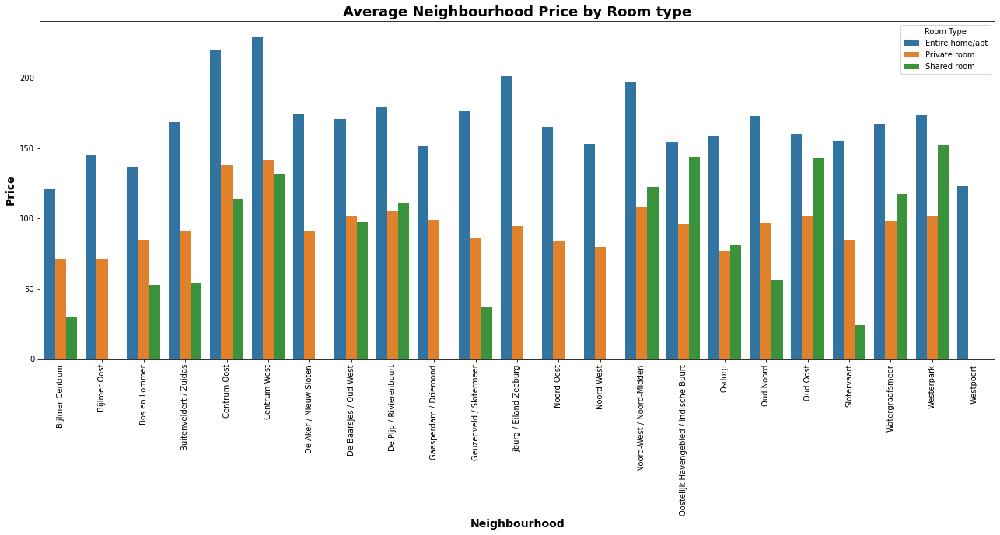

In [67]:
plt.figure(figsize= (22,8))
sns.barplot(data= df_NeiPRT, x="neighborhood", y="price", hue="room_type")
plt.xticks(rotation = 90)
plt.title("Average Neighbourhood Price by Room type", fontsize = 18, fontweight = "bold")
plt.xlabel("Neighbourhood",fontsize = 14, fontweight = "bold")
plt.ylabel("Price",fontsize = 14, fontweight = "bold")
plt.legend(title = "Room Type",loc = "upper right")
plt.show()

# Insights:-

#### From the above graph we can compare prices across each of the room types among various neighbourhoods and select the lowest price in the neighbourhood which is closest to the place of visit.

# Top 5 Neighbourhoods with maximum no. of bookings

In [68]:
df_NeiBookMax = pd.DataFrame(df_clean["neighborhood"].value_counts()[0:5])
df_NeiBookMax.reset_index(inplace=True)
df_NeiBookMax

,index,neighborhood
0,De Baarsjes / Oud West,3289
1,De Pijp / Rivierenbuurt,2378
2,Centrum West,2225
3,Centrum Oost,1730
4,Westerpark,1430


In [69]:
figure = px.bar(data_frame=df_NeiBookMax, x=df_NeiBookMax.index, y="neighborhood", color="neighborhood",
                color_continuous_scale="rainbow",title="<b> Top 5 Neighbourhood with max bookings </b>")
figure.update_layout(barmode='stack')
figure.show()

# Insights:-

#### From the above graph we can see that De Baarsjes / Oud West neighbourhood gets the max no. of bookings i.e. 3289 bookings

# Now, since we have the latitude and longitude coordinates of all the Airbnb properties, we can easily plot them on the map of Amsterdam so that it can be easy to locate all the properties with repect to their geographical location and vicinity to tourist places and other important places.

# We will use folium library to achieve this.

In [70]:
df_location = df_clean.groupby(["latitude","longitude","name"], as_index = True)
df_location

In [71]:
Property_Map = folium.Map(prefer_canvas = True)
def plotDot(point,axis):
    folium.CircleMarker(location=[point.latitude,point.longitude],radius=2,weight=5,popup = point.name).add_to(Property_Map)
df_location.apply(plotDot,axis = 1)
Property_Map.fit_bounds(Property_Map.get_bounds())
Property_Map    

# Above we can see a map of all the 18723 Airbnbs in the dataset at their proper location. When we click on any of the blue point on the mao we can see the name of that particular property.

# Conclusive Report using D Tale library

In [72]:
import dtale

In [73]:
final_report = dtale.show(df_clean)
final_report

# Conclusion

# We have successfully completed the data analysis of the Airbnb dataset.
### In this project we started with importing various libraries required for data analysis, visualisation and for plotting the map using the latitude and longitude .We then read the data set from the csv file into pandas data frame.
### We then carried out the initial investigation of the data set followed by automated exploratory data analysis using pandas profiling library.
### Then we performed data cleaning and preparation of the data set and obtained a clean data set without the missing values and null values.
### After this we performed the exploratory data analysis. 
### In this we identified the Top 10 earners as well as the bottom 10 earners.
### We then obtained the top locations with the highest number of bookings. 
### We then analysed price with respect to the location and the neighbourhood name with respect to the average price. 
### We then analysed the relationship between quality and price, price and amenities and price versus location. ### We then found out the number of properties with respect to the room type and the neighbourhood price by room type. 
### We also found the top 5 neighbourhoods with maximum booking. 
### All these findings were also plotted graphically using various charts to properly visualise the data and to draw insights more conveniently.
### We then plotted the latitude and the longitude coordinates of all the 18723 Airbnb properties. 
### At last we obtained a conclusive report using the D Tale library.